# Initial Notebook for CS224U Project

## Creating Data

In [1]:
from sklearn.model_selection import train_test_split
import csv
from sklearn.metrics import classification_report, accuracy_score, f1_score

In [2]:
questions = []
with open('../data/qbankAnon.csv', encoding='utf-8') as f:
    reader = csv.DictReader(f)
    for q in reader:
        questions.append([q['Question'], q['memAffi']])

In [3]:
X, y = zip(*list(questions))
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

train_data = set(zip(X_train, y_train))
test_data = set(zip(X_test, y_test))

In [4]:
with open('data/train_data.csv', 'w', encoding='utf-8') as f:
    writer = csv.writer(f)
    writer.writerows(train_data)

with open('data/test_data.csv', 'w', encoding='utf-8') as f:
    writer = csv.writer(f)
    writer.writerows(train_data)

In [5]:
def read_array_from_csv(inputcsv):
    out = []
    with open(inputcsv, encoding='utf-8') as f:
        reader = csv.reader(f)
        for q in reader:
            out.append(q)
    return out

In [6]:
new_train = read_array_from_csv('data/train_data.csv')

## Simple Model

### First, some feature functions

A unigrams feature function

In [7]:
def unigrams_phi(question):
    """The basis for a unigrams feature function.
    Parameters
    ----------
    question : string
        The question to represent.
    
    Returns
    -------    
    defaultdict
        A map from strings to their counts in the question. (Counter maps a 
        list to a dict of counts of the elements in that list.)
    """
    unigrams = {}
    for word in question.split() :
        unigrams[word] = unigrams.get(word, 0) + 1
    return unigrams

In [8]:
def unigrams_lower_phi(question):
    """The basis for a unigrams feature function.
    Parameters
    ----------
    question : string
        The question to represent.
    
    Returns
    -------    
    defaultdict
        A map from strings to their counts in the question. (Counter maps a 
        list to a dict of counts of the elements in that list.)
    """
    unigrams = {}
    for word in question.split() :
        unigrams[word.lower()] = unigrams.get(word.lower(), 0) + 1
    return unigrams

A bigrams feature function

In [9]:
def bigrams_phi(question):
    """The basis for a unigrams feature function.
    
    Parameters
    ----------
    tree : nltk.tree
        The tree to represent.
    
    Returns
    -------    
    defaultdict
        A map from strings to their counts in `tree`. (Counter maps a 
        list to a dict of counts of the elements in that list.)
    
    """
    bigrams = {}
    qarray = question.split()
    for i in range(0, len(qarray)-1) :
        big = qarray[i] + '_' + qarray[i+1]
        bigrams[big] = bigrams.get(big, 0) + 1
    return bigrams

In [10]:
def trigrams_phi(question):
    """The basis for a unigrams feature function.
    
    Parameters
    ----------
    tree : nltk.tree
        The tree to represent.
    
    Returns
    -------    
    defaultdict
        A map from strings to their counts in `tree`. (Counter maps a 
        list to a dict of counts of the elements in that list.)
    
    """
    bigrams = {}
    qarray = question.split()
    for i in range(0, len(qarray)-2) :
        big = qarray[i] + '_' + qarray[i+1] + '_' + qarray[i+2]
        bigrams[big] = bigrams.get(big, 0) + 1
    return bigrams

A basic bag-of-words unigrams and bigrams feature function

In [11]:
def uni_bigrams_phi(question):
    grams = unigrams_phi(question)
    grams.update(bigrams_phi(question))
    return grams

In [12]:
def first_word_phi(question):
    qarray = question.split()
    return {qarray[0]:1}

In [13]:
def second_word_phi(question):
    qarray = question.split()
    return {qarray[1]:1}

In [14]:
def constant_phi(question):
    return {'val':1}

In [15]:
def length_phi(question):
    return {'length_':len(question)}

In [16]:
from random import randint

In [17]:
def random_word_phi(question):
    qarray = question.split()
    word = qarray[randint(0, len(qarray)-1)]
    return {word:1}

In [18]:
def numwords_phi(question):
    return {'numwords_':len(question.split())}

We found that *friend* seems to be a good indicator. What happens if we only give the classifier that feature? Or unigrams without it?

In [19]:
def only_friend_phi(question):
    if 'friend' in question.lower().split():
        return {'friend':1}
    else:
        return {'friend':0}

In [20]:
def no_friends_phi(question):
    unigrams = {}
    for word in question.split() :
        if word.lower() is not 'friend':
            unigrams[word.lower()] = unigrams.get(word.lower(), 0) + 1
    return unigrams

### Now, let's bring in all the machinery from SST

In [21]:
import utils
import sst
import scipy.stats
from sgd_classifier import BasicSGDClassifier

To build a dataset, we need a reader

In [22]:
def hansard_reader(
        src_filename,
        class_func=None):
    """Overview

    Parameters
    ----------
    src_filename : str
        Full path to the file to be read.
    class_func : None, or function mapping labels to labels or None
        If this is None, then the original 5-way labels are returned.
        Other options: `binary_class_func` and `ternary_class_func`
        (or you could write your own).


    Yields
    ------
    (tree, label)
        nltk.Tree, str in {'0','1','2','3','4'}

    """
    if class_func is None:
        class_func = lambda x: x
    with open(src_filename, encoding='utf-8') as f:
        reader = csv.reader(f)
        for q in reader:
            yield (q[0], class_func(q[1]))
            
def train_reader(**kwargs):
    """Convenience function for reading the train file, full-trees only."""
    src = 'data/train_data.csv'
    return hansard_reader(src,**kwargs)

In [23]:
train_dataset = sst.build_dataset(
    reader=train_reader,
    phi=uni_bigrams_phi,
    class_func=None,
    vectorizer=None)

In [24]:
print("Train dataset with unigram features has {:,} examples and {:,} features".format(
        *train_dataset['X'].shape))

Train dataset with unigram features has 5,364 examples and 182,932 features


In [25]:
new_train[80]

[' I have a question from Abby, who wants to train to be a midwife, and $pronoun says:  “I am 28 years old. This year I left my successful career to go back into university to re-train as a Midwife. I already have a debt of £25,000 from my first degree.  Well over half of my cohort have studied a first degree in another subject and many of my fellow colleagues have children and partners and elderly parents and mortgages.  Many people will be put off by the lack of financial support and massive debts.”  In the spirit of Christmas, will the $person have a word with $pronoun friend the Chancellor, who is sitting next to him—it can be done very quickly—to reverse  the cuts in the nurse bursary scheme, so that we do get people like Abby training to be midwives, which will help all of us in the future?',
 'opp']

### Wrapper for SGD Classifier

In [26]:
def fit_basic_sgd_classifier(X, y):    
    """Wrapper for `BasicSGDClassifier`.
    
    Parameters
    ----------
    X : 2d np.array
        The matrix of features, one example per row.        
    y : list
        The list of labels for rows in `X`.
    
    Returns
    -------
    BasicSGDClassifier
        A trained `BasicSGDClassifier` instance.
    
    """    
    mod = BasicSGDClassifier()
    mod.fit(X, y)
    return mod

### Class Functions

In [27]:
def cas_to_gov(label):
    if label == 'cas':
        return 'gov'
    else:
        return label

### Experiments

In [28]:
_ = sst.experiment(
    no_friends_phi,
    fit_basic_sgd_classifier,
    train_reader=train_reader, 
    assess_reader=None, 
    train_size=0.7,
    class_func=cas_to_gov,
    score_func=utils.safe_macro_f1,
    verbose=True)

Accuracy: 0.770
             precision    recall  f1-score   support

        gov      0.705     0.792     0.746       687
        opp      0.829     0.753     0.789       923

avg / total      0.776     0.770     0.771      1610



In [29]:
from sklearn.linear_model import LogisticRegression

In [30]:
def fit_maxent_classifier(X, y):   
    mod = LogisticRegression(fit_intercept=True)
    mod.fit(X, y)
    return mod

In [31]:
_ = sst.experiment(
    no_friends_phi,
    fit_maxent_classifier,
    train_reader=train_reader, 
    assess_reader=None, 
    train_size=0.7,
    class_func=None,
    score_func=utils.safe_macro_f1,
    verbose=True)

Accuracy: 0.779
             precision    recall  f1-score   support

        cas      0.000     0.000     0.000         1
        gov      0.746     0.737     0.741       692
        opp      0.803     0.811     0.807       917

avg / total      0.778     0.779     0.778      1610



/Users/sparkes/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/Users/sparkes/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [32]:
# Which feature functions?
phi = unigrams_phi

# What reader do we use for testing? (None gives us a random split)
assess_reader = None

# What classifier function?
class_func = cas_to_gov

# Vectorise?
vectorize = True

#Train size
train_size = 0.7

Which model function thing are we to use?

In [33]:
classifier = LogisticRegression(fit_intercept=True)

In [34]:
def our_new_classifier(X, y):   
    mod = classifier
    mod.fit(X, y)
    return mod

train_func = our_new_classifier

In [35]:
train = sst.build_dataset(train_reader, phi, class_func, vectorize=vectorize)

In [36]:
# Manage the assessment set-up:
X_train = train['X']
y_train = train['y']
X_assess = None
y_assess = None
if assess_reader == None:
     X_train, X_assess, y_train, y_assess = train_test_split(
            X_train, y_train, train_size=train_size, test_size=None)
else:
    # Assessment dataset using the training vectorizer:
    assess = sst.build_dataset(
        assess_reader,
        phi,
        class_func,
        vectorizer=train['vectorizer'],
        vectorize=vectorize)
    X_assess, y_assess = assess['X'], assess['y']
# Train:
mod = train_func(X_train, y_train)
# Predictions:
predictions = mod.predict(X_assess)
# Report:
print('Accuracy: %0.03f' % sst.accuracy_score(y_assess, predictions))
print(classification_report(y_assess, predictions, digits=3))

Accuracy: 0.779
             precision    recall  f1-score   support

        gov      0.727     0.740     0.733       661
        opp      0.816     0.806     0.811       949

avg / total      0.780     0.779     0.779      1610



In [37]:
print(mod.coef_)

[[ 0.04839855  0.          0.07987178 ... -0.015491    0.02237416
  -0.09758718]]


In [38]:
print(train['vectorizer'].get_feature_names())

['$100', '$113', '$29.3', '$50', '$500', '$6.5', '$660', '$people', '$person', '$person,', '$person.', '$person.”', '$person:', '$person;', '$person?', '$persons', '$persons,', '$persons;', '$person—', '$person—Andy', '$person—Dodgy', '$person—I', '$person—[$people:', '$person—[Interruption.]', '$person—and', '$person—apparently', '$person—is', '$person—it', '$person—sorry,', '$person’s', '$person’s—he', '$person”,', '$pronoun', '%.', '&', '(Alan', '(Alex', '(Alistair', '(Anas', '(Andrea', '(Andrew', '(Andy', '(Angela', '(Angus', '(Anna', '(Anne', '(Article', '(Austin', '(Barbara', '(Bill', '(Boris', '(Caroline', '(Carolyn', '(Chloe', '(Chris', '(Claire', '(Conor', '(Damages)', '(Damian', '(David', '(Dawn', '(Debbie', '(Douglas', '(Dr', '(Drew', '(Edward', '(Elizabeth', '(Emily', '(Explosive', '(Extension', '(Fiona', '(Fitness', '(Gareth', '(Gavin', '(Gender', '(Geoffrey', '(George', '(Glyn', '(Graham', '(Grahame', '(Gregory', '(Guy', '(Heather', '(Heidi', '(Helen', '(Hilary', '(Huw', 

In [39]:
attempt = zip(mod.coef_[0], train['vectorizer'].get_feature_names())

In [40]:
print(attempt)

# Lime Analysis

In [41]:
import lime
import sklearn
import numpy as np
import sklearn
import sklearn.ensemble
import sklearn.metrics

In [42]:
from sklearn.feature_extraction.text import CountVectorizer

In [43]:
X_eval, y_eval = zip(*list(questions))
X_train, X_test, y_train, y_test = train_test_split(X_eval, y_eval, test_size=0.3)

train_data = set(zip(X_train, y_train))
test_data = set(zip(X_test, y_test))

In [44]:
h_evaldata = list(X_eval)
vectorizer = CountVectorizer()
eval_vectors = vectorizer.fit_transform(h_evaldata)
eval_dict = vectorizer.vocabulary_

In [45]:
h_traindata = list(X_train)
h_traintarget = list(y_train)

In [46]:
h_testdata = list(X_test)
h_testtarget = list(y_test)

In [47]:
def binariseHansard(party):
    out = 0
    if party == 'gov':
        out = 1
    return out

In [48]:
h_traintarget = [binariseHansard(item) for item in list(y_train)]
h_testtarget = [binariseHansard(item) for item in list(y_test)]

In [49]:
# vectorizer = sklearn.feature_extraction.text.TfidfVectorizer(lowercase=False)
vectorizer = CountVectorizer(vocabulary=eval_dict)
train_vectors = vectorizer.fit_transform(h_traindata)
test_vectors = vectorizer.fit_transform(h_testdata)

In [50]:
vectorizer.vocabulary_

{'if': 8019,
 'pronoun': 12231,
 'will': 17049,
 'list': 9407,
 'official': 10913,
 'engagements': 5732,
 'for': 6603,
 'wednesday': 16903,
 '10': 8,
 'march': 9778,
 'the': 15590,
 'whole': 17013,
 'house': 7882,
 'want': 16791,
 'to': 15742,
 'concur': 3690,
 'with': 17105,
 'words': 17169,
 'of': 10895,
 'condolence': 3700,
 'that': 15588,
 'person': 11548,
 'has': 7468,
 'offered': 10906,
 'those': 15641,
 'members': 9998,
 'rifles': 13384,
 'who': 17011,
 'lost': 9540,
 'their': 15595,
 'lives': 9437,
 'us': 16494,
 'served': 14011,
 'regiment': 12864,
 'now': 10789,
 'become': 1977,
 'we': 16870,
 'feel': 6333,
 'loss': 9537,
 'families': 6235,
 'very': 16613,
 'intensely': 8444,
 'but': 2720,
 'it': 8643,
 'is': 8606,
 'matched': 9854,
 'pride': 12094,
 'at': 1577,
 'what': 16961,
 'and': 1211,
 'today': 15744,
 'army': 1433,
 'federation': 6325,
 'carried': 2899,
 'out': 11076,
 'postal': 11894,
 'trials': 15972,
 'which': 16982,
 'prove': 12303,
 'unlikely': 16342,
 'vast': 16

In [51]:
# rf = sklearn.ensemble.RandomForestClassifier(n_estimators=500)
rf = sklearn.linear_model.SGDClassifier(max_iter=10, learning_rate='constant', eta0=0.1, loss='log')
rf.fit(train_vectors, h_traintarget)

SGDClassifier(alpha=0.0001, average=False, class_weight=None, epsilon=0.1,
       eta0=0.1, fit_intercept=True, l1_ratio=0.15,
       learning_rate='constant', loss='log', max_iter=10, n_iter=None,
       n_jobs=1, penalty='l2', power_t=0.5, random_state=None,
       shuffle=True, tol=None, verbose=0, warm_start=False)

In [52]:
# from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix
# print(f1_score(y_test, y_pred, average="macro"))
#     print(precision_score(y_test, y_pred, average="macro"))
#     print(recall_score(y_test, y_pred, average="macro"))  

In [53]:
pred = rf.predict(test_vectors)
sklearn.metrics.f1_score(h_testtarget, pred)

0.7417746759720837

In [54]:
from lime import lime_text
from sklearn.pipeline import make_pipeline
c = make_pipeline(vectorizer, rf)

In [55]:
print(c.predict_proba([h_traindata[25]]))

[[9.19222615e-07 9.99999081e-01]]


In [56]:
class_names = ['opp', 'gov']

In [57]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)

In [58]:
explainer

In [ ]:
for idx in range(len(h_testtarget)):
    if .55 > c.predict_proba([h_testdata[idx]])[0,1] > .5:
        exp = explainer.explain_instance(h_testdata[idx], c.predict_proba, num_features=200)
        print('Document id: %d' % idx)
        print('Probability(gov) =', c.predict_proba([h_testdata[idx]])[0,1])
        print('True class: %s' % class_names[h_testtarget[idx]])
        %matplotlib inline
        fig = exp.as_pyplot_figure()
        exp.show_in_notebook(text=True)
        input('Press enter')       

Document id: 36
Probability(gov) = 0.5230322714147552
True class: opp


/Users/sparkes/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Press enter
Document id: 80
Probability(gov) = 0.542950235900385
True class: opp


Press enter
Document id: 96
Probability(gov) = 0.5002886721740291
True class: gov


Press enter
Document id: 224
Probability(gov) = 0.5499384493844497
True class: opp


Press enter
Document id: 682
Probability(gov) = 0.5239006314145748
True class: gov


Press enter
Document id: 715
Probability(gov) = 0.5026903875183311
True class: opp


Press enter
Document id: 739
Probability(gov) = 0.5454230000991379
True class: opp


Press enter
Document id: 783
Probability(gov) = 0.5035549235372448
True class: opp


Press enter
Document id: 807
Probability(gov) = 0.5136417201996794
True class: gov


Press enter
Document id: 821
Probability(gov) = 0.5093581131047433
True class: opp


Press enter
Document id: 888
Probability(gov) = 0.5348879098482039
True class: gov


Press enter
Document id: 915
Probability(gov) = 0.5189045874162775
True class: opp


Press enter
Document id: 986
Probability(gov) = 0.5302420085617132
True class: opp


Press enter
Document id: 1023
Probability(gov) = 0.525260745463822
True class: opp


Press enter
Document id: 1112
Probability(gov) = 0.5104380786906005
True class: gov


Press enter
Document id: 1114
Probability(gov) = 0.5252258746263929
True class: gov


In [63]:
idx = 20
exp = explainer.explain_instance(h_testdata[idx], c.predict_proba, num_features=200)
print('Document id: %d' % idx)
print('Probability(gov) =', c.predict_proba([h_testdata[idx]])[0,1])
print('True class: %s' % class_names[h_testtarget[idx]])

/Users/sparkes/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Document id: 20
Probability(gov) = 0.11317788191670941
True class: opp


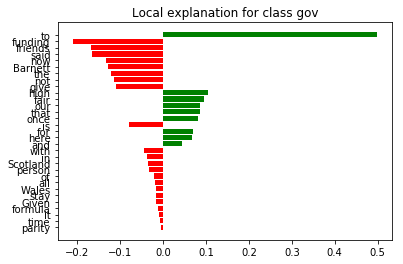

In [64]:
%matplotlib inline
fig = exp.as_pyplot_figure()

In [65]:
exp.show_in_notebook(text=True)